In [5]:
import os
import time
import pandas as pd
import numpy as np
from scipy import signal
import seaborn as sns

import matplotlib.pyplot as plt

In [8]:
# all_feature_df =pd.read_csv("./temp/transient_resistance_features_df_delete_outlier.csv")
col = [i for i in all_feature_df.columns.values if i[:4] == "IGBT"]
col.append("time")
thermal_feature_df = all_feature_df.loc[:,col]
thermal_feature_df.head()

,IGBT3_1_delta_T_min,IGBT3_1_delta_T_max,IGBT3_1_delta_T_range,IGBT3_1_delta_T_mean,IGBT3_1_delta_T_mode,IGBT3_1_delta_T_median,IGBT3_1_delta_T_quantile25,IGBT3_1_delta_T_quantile75,IGBT3_1_delta_T_std,IGBT3_1_delta_T_var,...,IGBT3_1_delta_T_sra,IGBT3_1_delta_T_I,IGBT3_1_delta_T_sf,IGBT3_1_delta_T_MI,IGBT3_1_delta_T_CF,IGBT3_1_delta_T_llr,IGBT3_1_delta_T_pi,IGBT3_1_delta_T_sdif,IGBT3_1_delta_T_cpt1,time
0,6.643049,35.952522,29.309474,31.042804,6.643049,33.101299,30.017462,34.817130,5.991970,35.903704,...,30.633810,1.158160,1.018276,0.956769,0.927218,1.920597,1.158160,0.193023,1.173622,1578087010
1,7.633753,36.000928,28.367175,31.280815,7.633753,33.162783,30.118794,34.949158,5.616769,31.548095,...,30.943135,1.150895,1.015834,0.916752,0.892720,2.000128,1.150895,0.179560,1.163454,1578087040
2,8.802762,35.979594,27.176832,31.437046,8.802762,33.227637,30.286985,34.846192,5.314770,28.246783,...,31.143600,1.144497,1.014049,0.872630,0.852507,2.071157,1.144497,0.169061,1.155280,1578087070
3,8.499044,36.095998,27.596954,31.382736,8.499044,33.185659,30.228879,34.994073,5.502444,30.276893,...,31.064438,1.150186,1.015103,0.888378,0.866284,2.026979,1.150186,0.175333,1.161972,1578087110
4,7.424558,36.018822,28.594264,31.256504,7.424558,33.105952,30.076312,34.929665,5.669475,32.142948,...,30.907629,1.152362,1.016155,0.925152,0.900282,1.988406,1.152362,0.181385,1.165370,1578087140


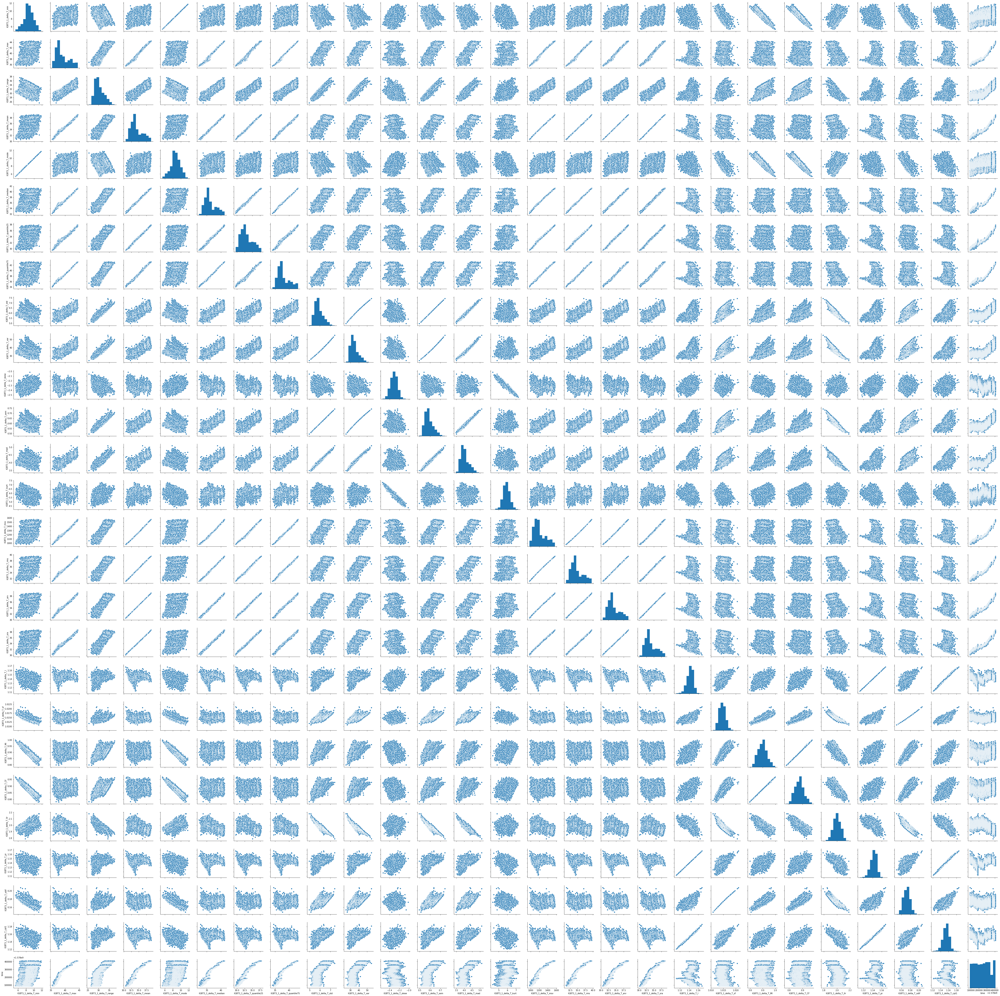

In [10]:
sns.pairplot(thermal_feature_df) 

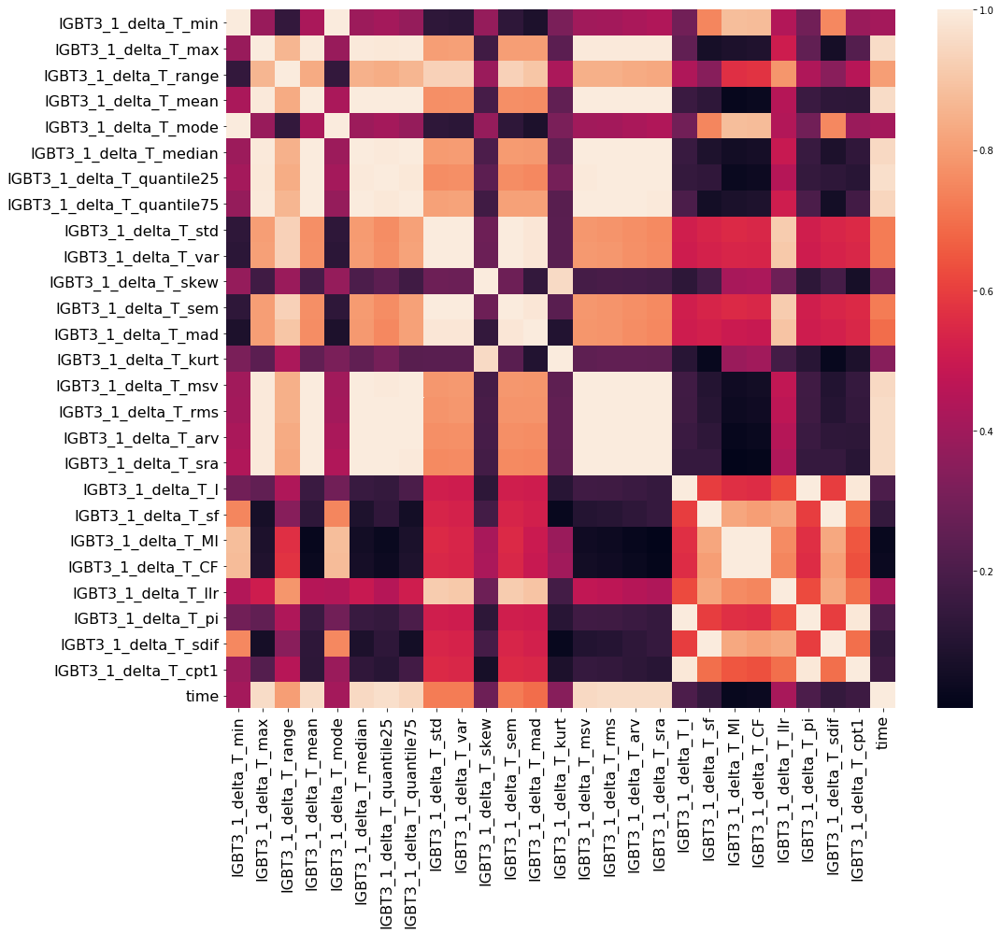

In [9]:
corr_df = thermal_feature_df.corr()
corr_df = abs(corr_df)
corr_df.to_csv("temp/coelationship_outliners.csv")
plt.figure(figsize=(16,14))
sns.heatmap(corr_df)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.savefig('temp/correlationship_bas'+'.png')

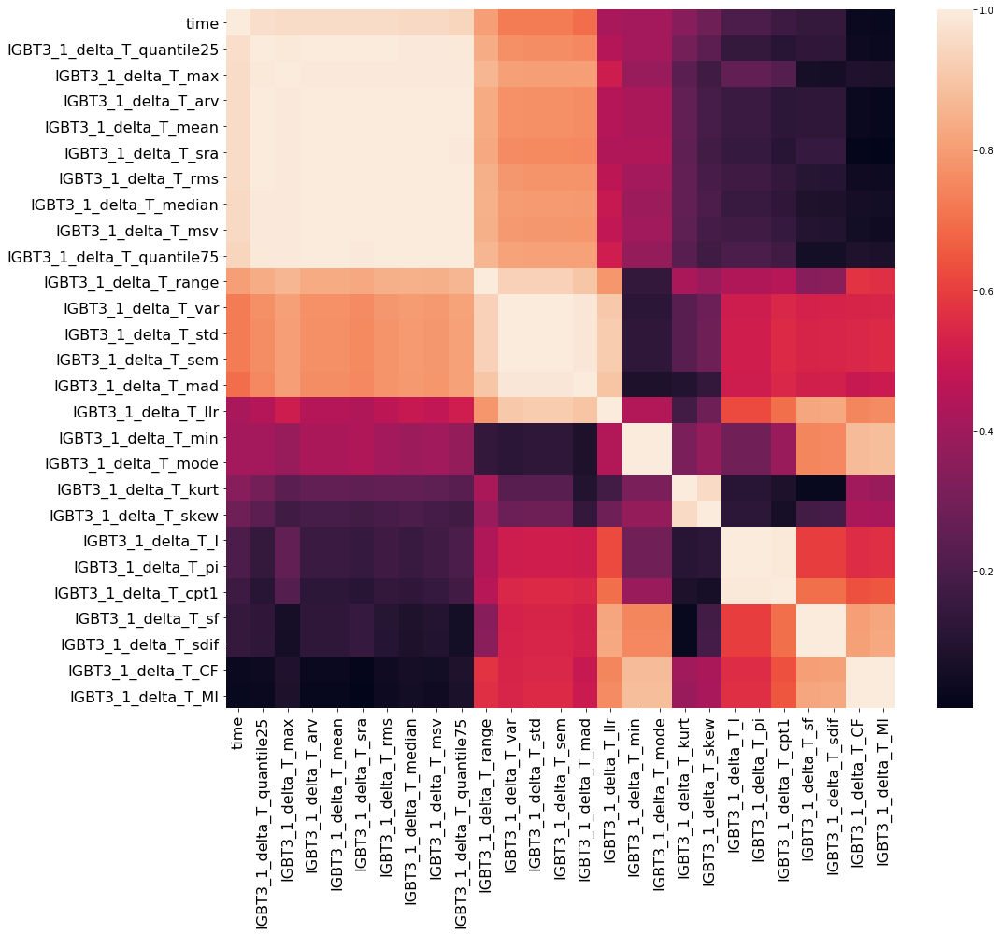

In [11]:
corr_df_abs_sort = corr_df.sort_values(by = "time",axis = 0, ascending = False, inplace = False)
corr_df_abs_sort = corr_df_abs_sort.sort_values(by = "time",axis = 1, ascending = False, inplace = False)
corr_df_abs_sort.to_csv("temp/coelationship_abs_sort.csv")
plt.figure(figsize=(16,14))
sns.heatmap(corr_df_abs_sort)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.tight_layout()
plt.savefig('temp/correlationship_abs_sort'+'.png')

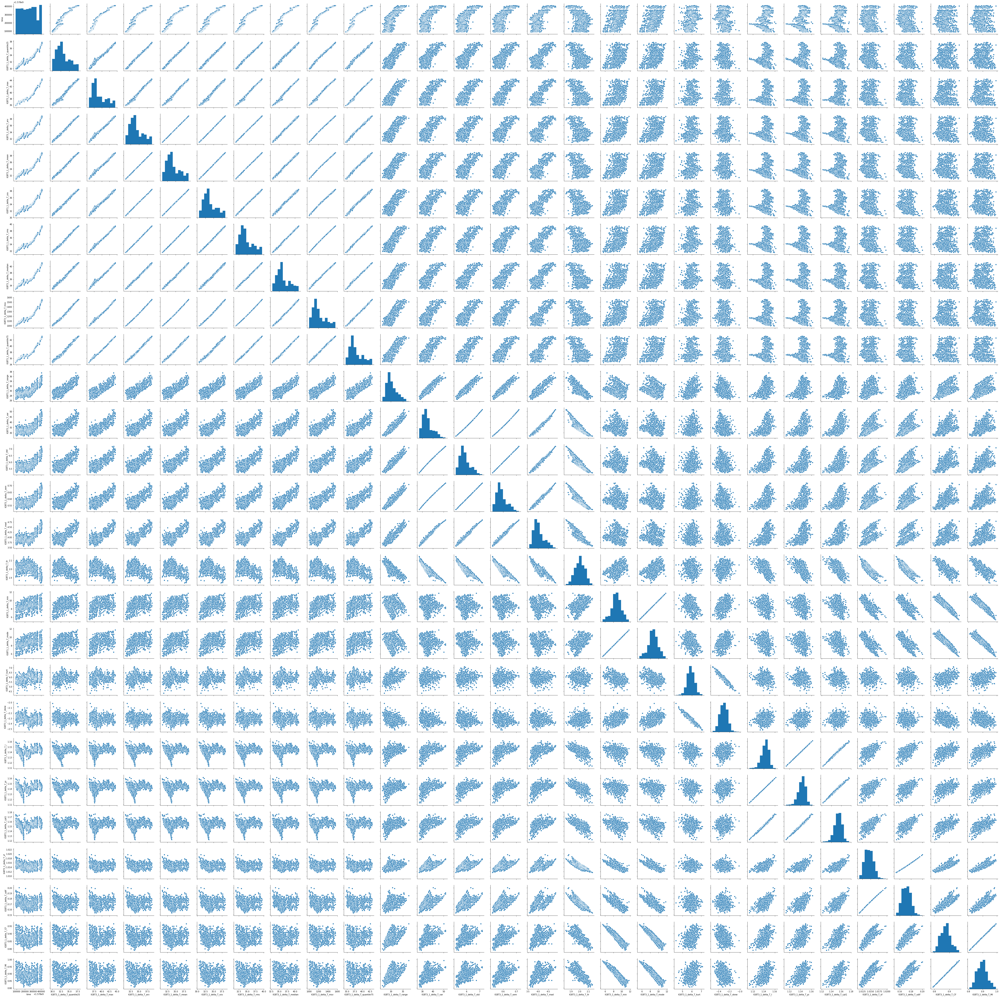

In [12]:
cols = corr_df_abs_sort.columns.values
thermal_feature_df = all_feature_df.loc[::10,cols]
sns.pairplot(thermal_feature_df) 
plt.savefig('temp/pairplot'+'.png')

In [25]:
cols[20]

'IGBT3_1_delta_T_I'

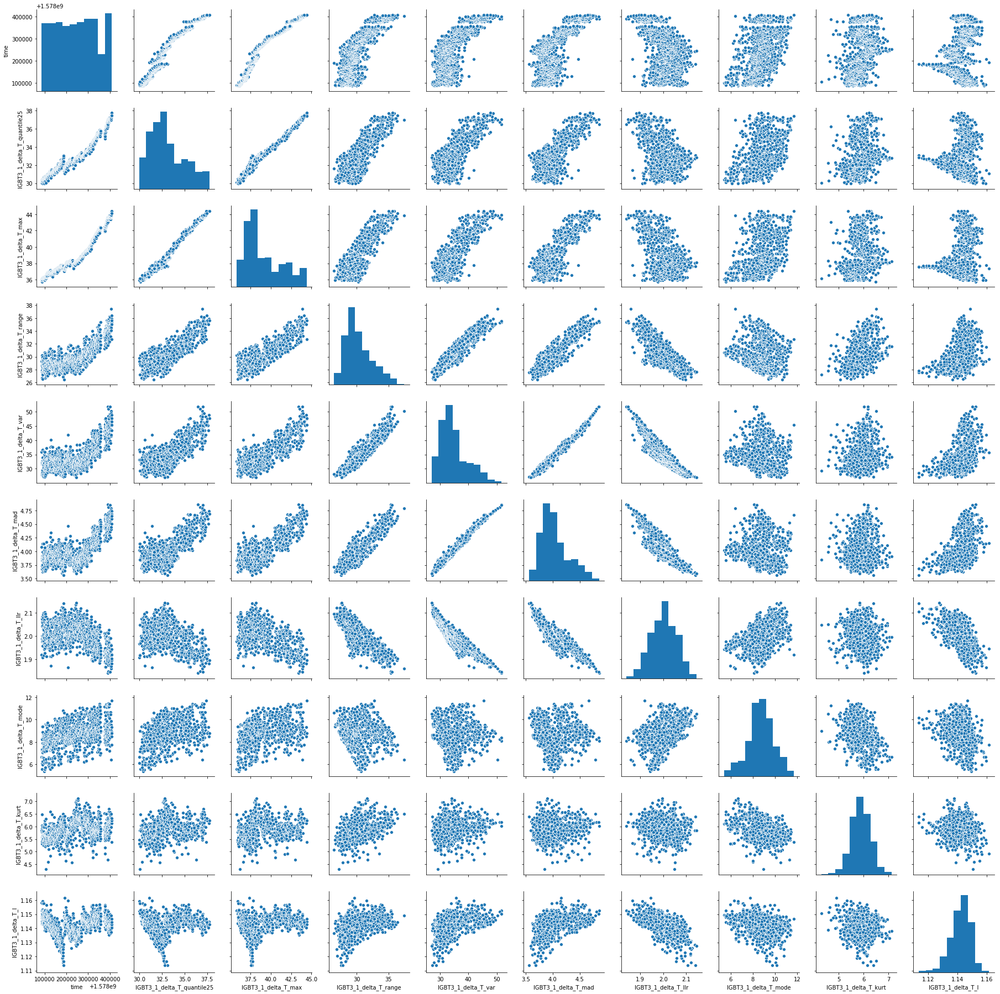

In [26]:
selected_features = ["time", # target
                     "IGBT3_1_delta_T_quantile25","IGBT3_1_delta_T_max","IGBT3_1_delta_T_range","IGBT3_1_delta_T_var","IGBT3_1_delta_T_mad","IGBT3_1_delta_T_llr",
                     "IGBT3_1_delta_T_mode","IGBT3_1_delta_T_kurt","IGBT3_1_delta_T_I" # not so correlated
                    ]
select_feature_df = all_feature_df.loc[::10,selected_features]
sns.pairplot(select_feature_df) 
plt.savefig('temp/pairplot_select_feature_df'+'.png')